<a href="https://colab.research.google.com/github/GijungLee/Kmnist_AutoEncoder_Project/blob/main/Copy_of_project2_swissroll_kmnist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd 
import random 
import torch
import torchvision
from torchvision import transforms
import torch.utils.data as Data
from torch.utils.data import DataLoader,random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from tqdm import tqdm
from sklearn.manifold import TSNE
import plotly
import plotly.express as px
from plotly.subplots import make_subplots
import tensorflow as tf
from torch import distributions as D
from torch.distributions.mixture_same_family import MixtureSameFamily

In [ ]:
X_train = np.load("kmnist-train-imgs.npz")["arr_0"].astype("float32").reshape(-1, 784)/255
y_train = np.load("kmnist-train-labels.npz")["arr_0"]
X_test = np.load("kmnist-test-imgs.npz")["arr_0"].astype("float32").reshape(-1, 784)/255
y_test = np.load("kmnist-test-labels.npz")["arr_0"]

In [ ]:
X_train = torch.tensor(X_train)
y_train = torch.tensor(y_train)
X_test = torch.tensor(X_test)
y_test = torch.tensor(y_test)

batch_size = 1000

train_dataset = Data.TensorDataset(X_train, y_train)
m = len(train_dataset)
train_dataset, val_dataset = random_split(train_dataset, [int(m-m*0.2), int(m*0.2)])
train_dataloader = Data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = Data.DataLoader(val_dataset, batch_size=batch_size, shuffle=True)
test_dataset = Data.TensorDataset(X_test, y_test)
test_dataloader = Data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [ ]:
def swiss_roll(n_samples,noise=0.1):
    t = 1.5*torch.pi*(1.0+2.0*torch.rand(1,n_samples))
    x = t*torch.cos(t)
    y = 21*torch.rand(1,n_samples)
    z = t*torch.sin(t)
    X = torch.cat((x,y,z),0)    
    # X = torch.cat((x,z),0)    
    X += noise*torch.randn(3,n_samples)
    X = X.T
    return X

In [ ]:
def normal_distribution(shape):
        N = torch.distributions.Normal(0, 1)
        N = N.sample(shape)
        return N

In [ ]:
class Regularizer():
    def __init__(self, scale=1., ksize=1000):
        super(Regularizer, self).__init__()
        self.scale = scale
        # self.distribution = distribution
        self.ksize = ksize
    
    def get_kernel(self, X, Z):
        X = X.to(device)
        Z = Z.to(device)
        G = torch.sum((torch.unsqueeze(X, dim=1) - Z)**2, axis=-1)
        G = torch.exp(-G/(2*(self.ksize))) / np.sqrt(2*np.pi*self.ksize)
        # G = torch.exp(-G/(2*(self.ksize**2))) / (np.sqrt(2*np.pi)*self.ksize)
        return G

In [ ]:
class Encoder(nn.Module):
    def __init__(self, latent_dims):
        super(Encoder, self).__init__()
        self.linear1 = nn.Linear(784, 800)
        self.linear2 = nn.Linear(800, 400)
        self.linear3 = nn.Linear(400, latent_dims)
        # self.linear4 = nn.Linear(400, latent_dims)
        # self.N = normal_distribution((1000, 3))
        # self.N = torch.distributions.Normal(0, 5)
        # self.S = swiss_roll(1000)
        self.csd = 0
        
    def forward(self, x):
        x = x.to(device)
#         x = torch.flatten(x, 1)
        x = F.tanh(self.linear1(x))
        x = F.tanh(self.linear2(x))
        x = self.linear3(x)
#         x1 = F.tanh(self.linear3(x))
#         p1 = self.linear4(x)
#         vxx = Regularizer().get_kernel(p1, p1)
#         vzz = Regularizer().get_kernel(self.N, self.N)
#         vxz = Regularizer().get_kernel(p1, self.N)
#         self.csd = torch.log(torch.sqrt(torch.mean(vxx)*torch.mean(vzz)) /
#                                    torch.mean(vxz))
        # vxx = Regularizer().get_kernel(x, x)
        # vzz = Regularizer().get_kernel(self.N.sample(x.shape), self.N.sample(x.shape))
        # vxz = Regularizer().get_kernel(x, self.N.sample(x.shape))
        # self.csd = torch.log(torch.sqrt(torch.mean(vxx)*torch.mean(vzz)) /
        #                            torch.mean(vxz))
        
        # vxx = Regularizer().get_kernel(x, x)
        # vzz = Regularizer().get_kernel(swiss_roll(x.shape[0]), swiss_roll(x.shape[0]))
        # vxz = Regularizer().get_kernel(x, swiss_roll(x.shape[0]))
        # self.csd = torch.log(torch.sqrt(torch.mean(vxx)*torch.mean(vzz)) /
        #                            torch.mean(vxz))
        S = swiss_roll(1000)
        vxx = Regularizer().get_kernel(x, x)
        vzz = Regularizer().get_kernel(S, S)
        vxz = Regularizer().get_kernel(x, S)
        self.csd = torch.log(torch.sqrt(torch.mean(vxx)*torch.mean(vzz)) /
                                   torch.mean(vxz))
        
        return x

In [ ]:
class Decoder(nn.Module):
    def __init__(self, latent_dims):
        super().__init__()
        self.decoder_lin = nn.Sequential(
            nn.Linear(latent_dims, 400),
            nn.ReLU(),
            nn.Linear(400, 800),
            nn.ReLU(),
            nn.Linear(800, 784),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.decoder_lin(x)
        return x

In [ ]:
class Autoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(Autoencoder, self).__init__()
        self.encoder = Encoder(latent_dims)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        x = x.to(device)
        z = self.encoder(x)
        # print(self.encoder.csd)
        return self.decoder(z)

In [ ]:
def train_epoch(ae, device, dataloader, optimizer,lam=100):
    # Set train mode for both the encoder and the decoder
    criterion = nn.MSELoss()
    ae.train()
    train_loss = 0.0
    # dataloader = train_dataloader(dataset)
    lam = lam
    # mse_loss = []
    csd = 0.0
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for x, _ in dataloader: 
        # Move tensor to the proper device
        x = x.to(device)
        x_hat = ae(x)
        # Evaluate loss
        loss = criterion(x, x_hat) + lam * ae.encoder.csd
        # mse_loss.append(criterion(x, x_hat))
        # csd.append(ae.encoder.csd)
#         loss = criterion(x, x_hat)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
#         print('\t partial train loss (single batch): %f' % (loss.item()))
        train_loss+=loss.item()
        csd+=ae.encoder.csd
    return (train_loss / len(dataloader)), (csd/len(dataloader))

In [ ]:
### Testing function
def test_epoch(ae, device, dataloader):
    # Set evaluation mode for encoder and decoder
    criterion = nn.MSELoss()
    ae.eval()
    val_loss = 0.0
    # dataloader = test_dataloader(dataset)
    with torch.no_grad(): # No need to track the gradients
        for x, _ in dataloader:
            # Move tensor to the proper device
            x = x.to(device)
            # Encode data
            encoded_data = ae.encoder(x)
            # Decode data
            x_hat = ae(x)
#             loss = (((x - x_hat)**2).sum()/(x.size(0))) + ae.encoder.csd
#             loss = criterion(x, x_hat) + ae.encoder.csd
            loss = criterion(x, x_hat)
            val_loss += loss.item()

    return val_loss / len(dataloader)

In [ ]:
def plot_ae_outputs(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
        ax = plt.subplot(2,n,i+1)
        img = test_dataset[i][0].unsqueeze(0).to(device)
        encoder.eval()
        decoder.eval()
        with torch.no_grad():
            rec_img  = decoder(encoder(img))
        plt.imshow(img.cpu().squeeze().reshape(28,28).numpy(), cmap='gist_gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Original images')
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(rec_img.cpu().squeeze().reshape(28,28).numpy(), cmap='gist_gray')  
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)  
        if i == n//2:
            ax.set_title('Reconstructed images')
    plt.show()

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(21)

d = 3
ae2 = Autoencoder(latent_dims=d)
# ae2.load_state_dict(torch.load("/content/drive/MyDrive/project2/Swiss_roll_best_1"))
lr = 1e-3

# optim = torch.optim.Adam(ae2.parameters(), lr=lr, weight_decay=1e-5)
optim = torch.optim.Adam(ae2.parameters(), lr=lr)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

ae2.to(device)

Selected device: cuda


Autoencoder(
  (encoder): Encoder(
    (linear1): Linear(in_features=784, out_features=800, bias=True)
    (linear2): Linear(in_features=800, out_features=400, bias=True)
    (linear3): Linear(in_features=400, out_features=3, bias=True)
  )
  (decoder): Decoder(
    (decoder_lin): Sequential(
      (0): Linear(in_features=3, out_features=400, bias=True)
      (1): ReLU()
      (2): Linear(in_features=400, out_features=800, bias=True)
      (3): ReLU()
      (4): Linear(in_features=800, out_features=784, bias=True)
      (5): Sigmoid()
    )
  )
)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1795: UserWarning:

nn.functional.tanh is deprecated. Use torch.tanh instead.




 EPOCH 1/100 	 train loss 0.5401509540776411 	 val loss 0.10924591620763142 	 csd 0.004217938054352999


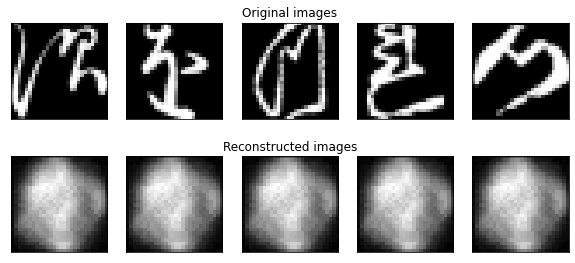


 EPOCH 2/100 	 train loss 0.2557006385177374 	 val loss 0.10917947255074978 	 csd 0.001466466928832233


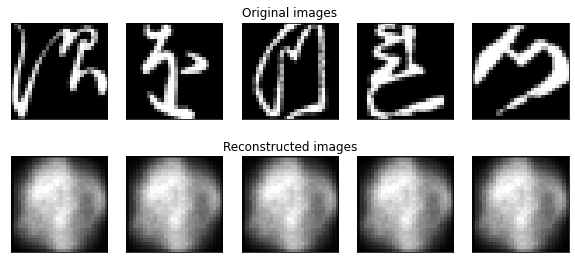


 EPOCH 3/100 	 train loss 0.256206501275301 	 val loss 0.10916553313533466 	 csd 0.0014715440338477492


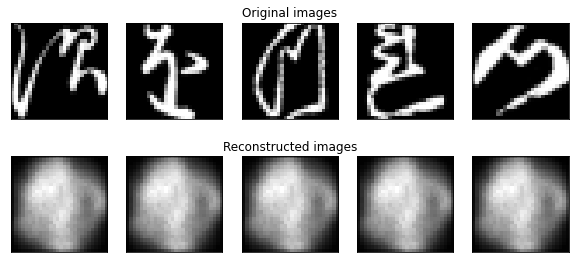


 EPOCH 4/100 	 train loss 0.2595088928937912 	 val loss 0.10921291758616765 	 csd 0.0015046494081616402


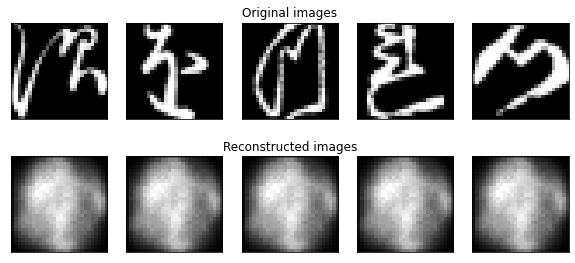


 EPOCH 5/100 	 train loss 0.2588600938518842 	 val loss 0.10928359255194664 	 csd 0.0014972774079069495


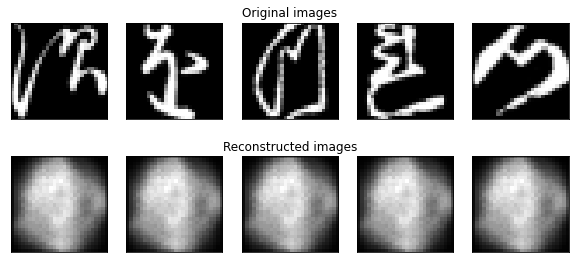


 EPOCH 6/100 	 train loss 0.25625399593263865 	 val loss 0.10917052750786145 	 csd 0.0014717155136168003


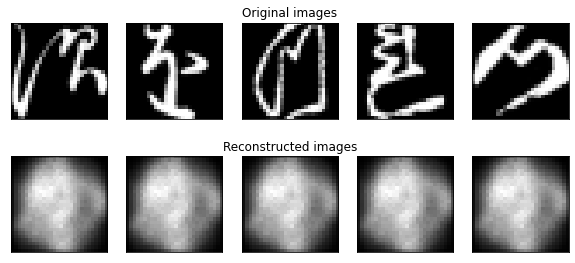


 EPOCH 7/100 	 train loss 0.2568346653133631 	 val loss 0.10918654004732768 	 csd 0.001477757003158331


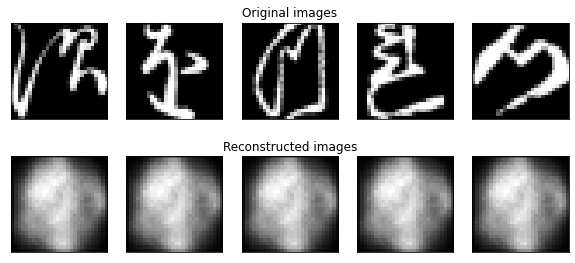


 EPOCH 8/100 	 train loss 0.25831111644705135 	 val loss 0.10917490720748901 	 csd 0.0014925883151590824


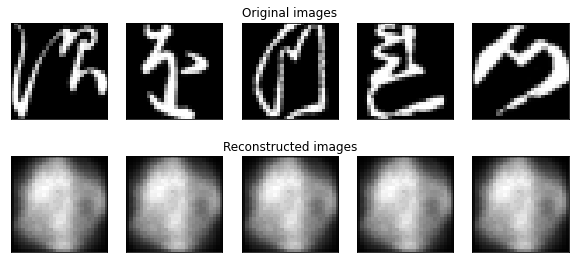


 EPOCH 9/100 	 train loss 0.2575988012055556 	 val loss 0.10928076754013698 	 csd 0.0014852001331746578


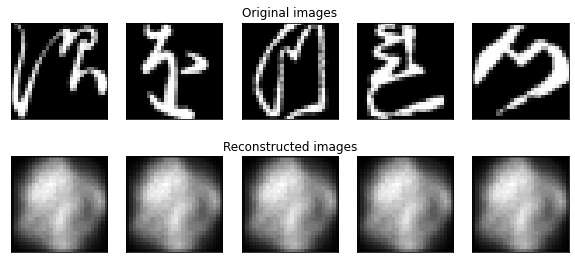


 EPOCH 10/100 	 train loss 0.2539096949622035 	 val loss 0.10920718374351661 	 csd 0.0014482749393209815


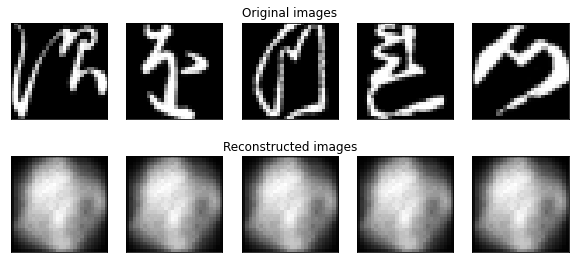


 EPOCH 11/100 	 train loss 0.255986664754649 	 val loss 0.10916701704263687 	 csd 0.0014687471557408571


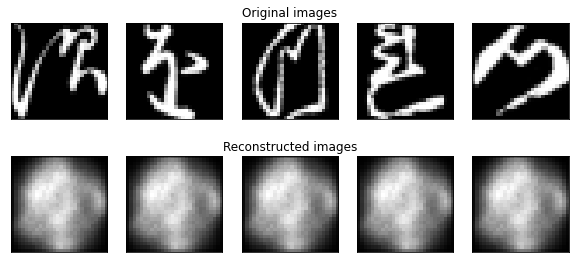


 EPOCH 12/100 	 train loss 0.2575954621036847 	 val loss 0.10911462580164273 	 csd 0.0014855705667287111


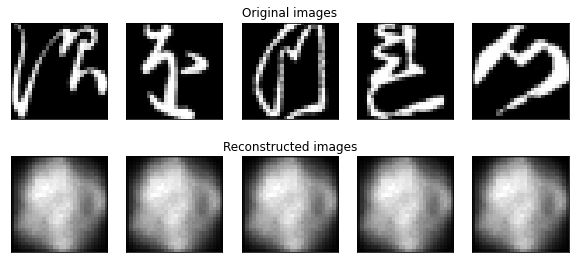


 EPOCH 13/100 	 train loss 0.25843205240865547 	 val loss 0.1091058428088824 	 csd 0.0014942082343623042


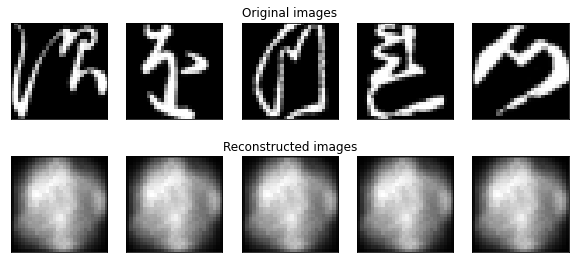


 EPOCH 14/100 	 train loss 0.2568787944813569 	 val loss 0.10906134111185868 	 csd 0.00147819216363132


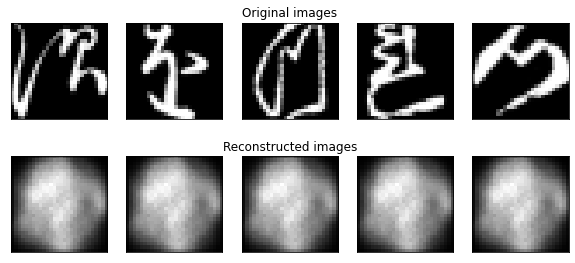


 EPOCH 15/100 	 train loss 0.25748025129238766 	 val loss 0.10916186807056268 	 csd 0.0014848413411527872


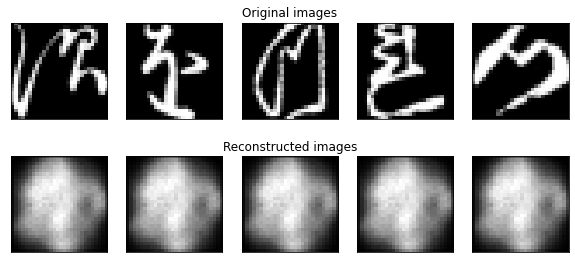


 EPOCH 16/100 	 train loss 0.2567597671101491 	 val loss 0.10908386359612147 	 csd 0.0014773498987779021


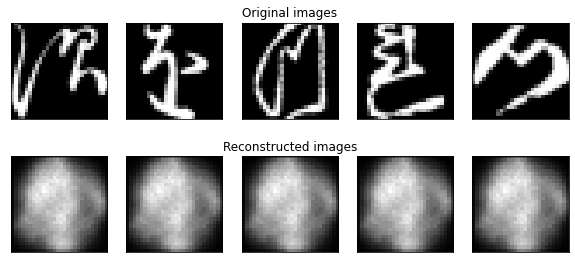


 EPOCH 17/100 	 train loss 0.2584495674818754 	 val loss 0.10864988217751186 	 csd 0.0014933703932911158


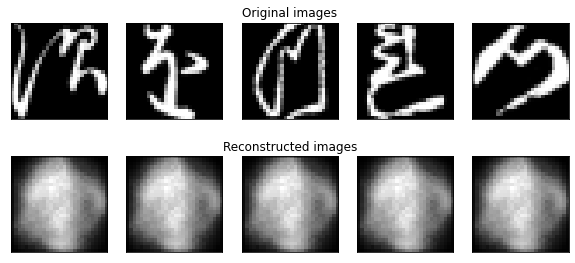


 EPOCH 18/100 	 train loss 0.25521768039713305 	 val loss 0.11021947488188744 	 csd 0.0014668386429548264


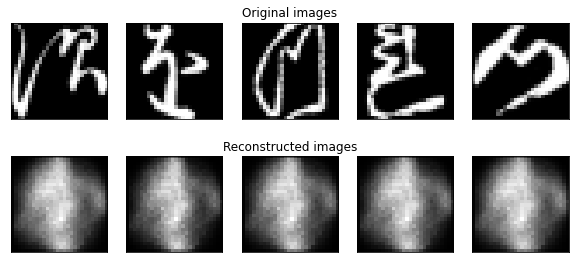


 EPOCH 19/100 	 train loss 0.25217414523164433 	 val loss 0.09973476765056451 	 csd 0.001480914419516921


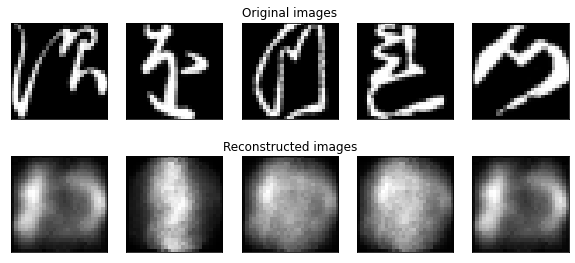


 EPOCH 20/100 	 train loss 0.24599834500501552 	 val loss 0.09811005741357803 	 csd 0.001472485950216651


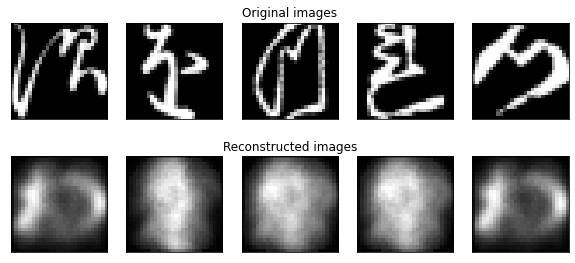


 EPOCH 21/100 	 train loss 0.24398487092306217 	 val loss 0.09928576027353604 	 csd 0.0014558755792677402


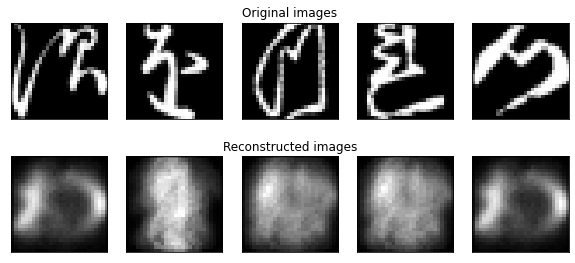


 EPOCH 22/100 	 train loss 0.24414992363502583 	 val loss 0.09800900208453338 	 csd 0.0014472728362306952


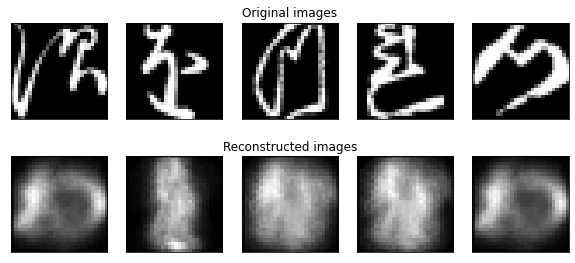


 EPOCH 23/100 	 train loss 0.24138588923960924 	 val loss 0.0975475690017144 	 csd 0.0014450824819505215


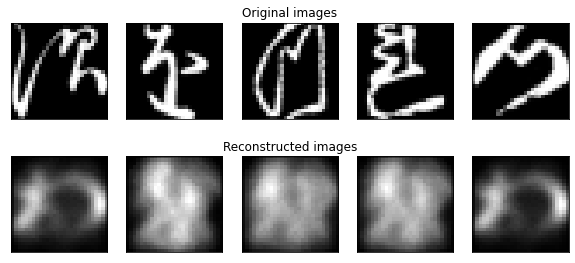


 EPOCH 24/100 	 train loss 0.2435478155190746 	 val loss 0.09580072698493798 	 csd 0.0014701917534694076


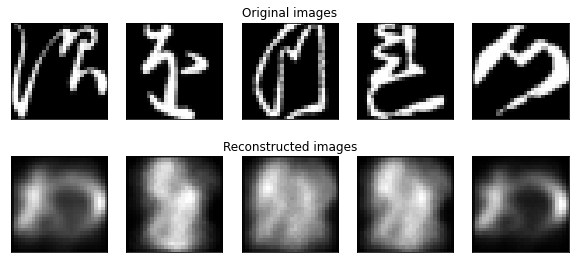


 EPOCH 25/100 	 train loss 0.244265904960533 	 val loss 0.0964606845130523 	 csd 0.0014820019714534283


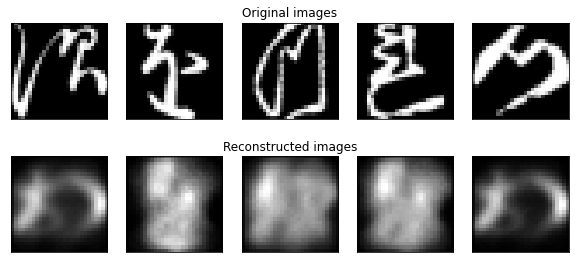


 EPOCH 26/100 	 train loss 0.24117515484491983 	 val loss 0.09569875275095303 	 csd 0.0014484453713521361


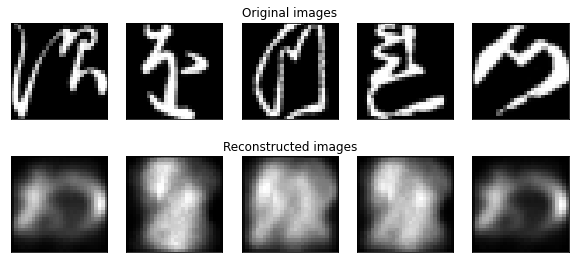


 EPOCH 27/100 	 train loss 0.24138616832594076 	 val loss 0.09531991680463155 	 csd 0.0014540263218805194


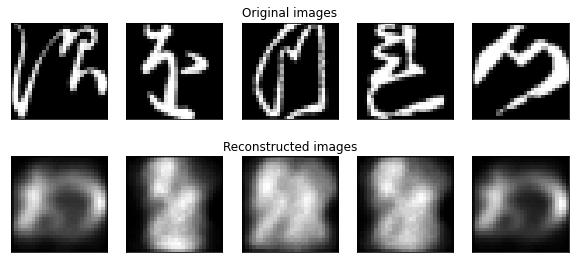


 EPOCH 28/100 	 train loss 0.24566927459090948 	 val loss 0.09743685834109783 	 csd 0.0014791146386414766


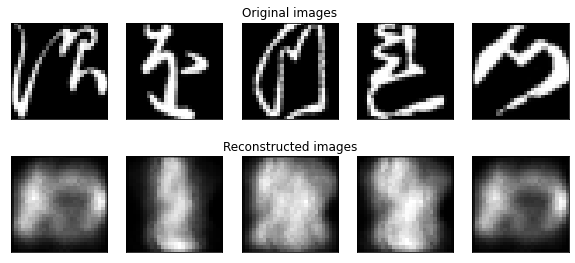


 EPOCH 29/100 	 train loss 0.24135210427145162 	 val loss 0.09558053935567538 	 csd 0.001451848424039781


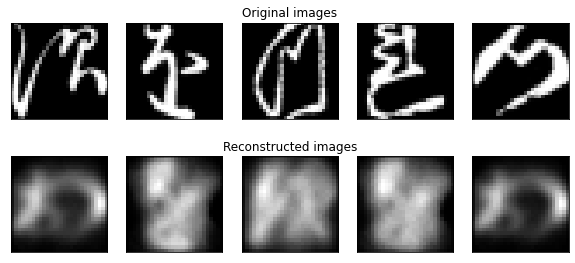


 EPOCH 30/100 	 train loss 0.23947166682531437 	 val loss 0.09553358828028043 	 csd 0.0014394992031157017


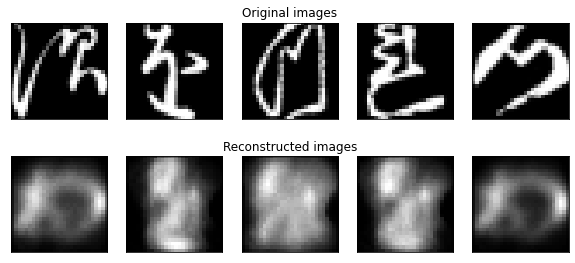


 EPOCH 31/100 	 train loss 0.23857655810813108 	 val loss 0.09520699580510457 	 csd 0.0014324537478387356


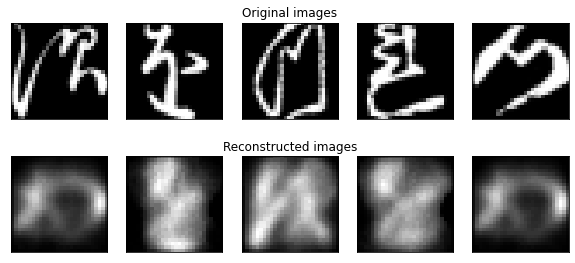


 EPOCH 32/100 	 train loss 0.23051018981883922 	 val loss 0.09562427240113418 	 csd 0.0013478293549269438


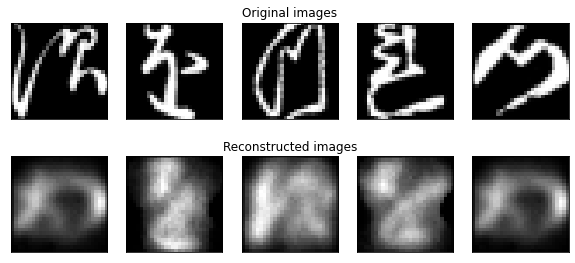


 EPOCH 33/100 	 train loss 0.22755910425136486 	 val loss 0.09620707482099533 	 csd 0.00131053919903934


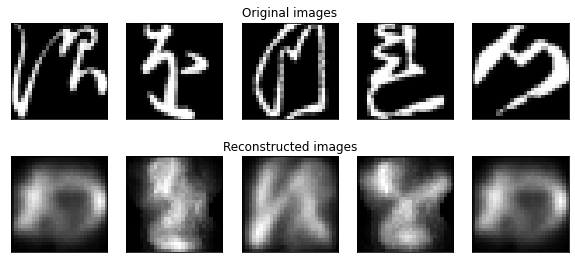


 EPOCH 34/100 	 train loss 0.21329494379460812 	 val loss 0.0961873469253381 	 csd 0.0011707980884239078


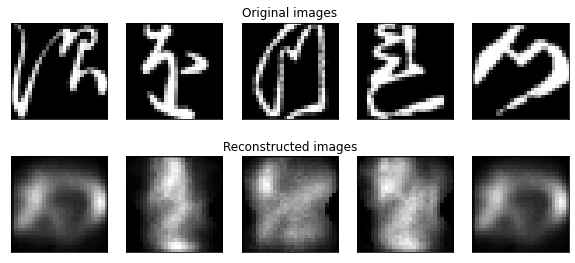


 EPOCH 35/100 	 train loss 0.2035396285355091 	 val loss 0.09620810548464458 	 csd 0.001065956661477685


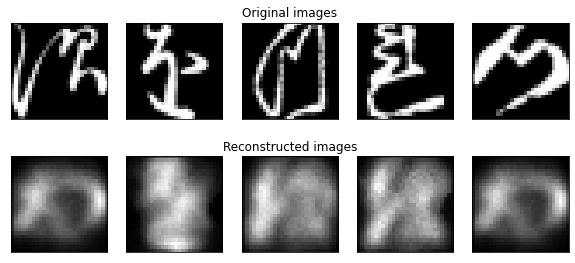


 EPOCH 36/100 	 train loss 0.19423987778524557 	 val loss 0.09747452475130558 	 csd 0.0009815589291974902


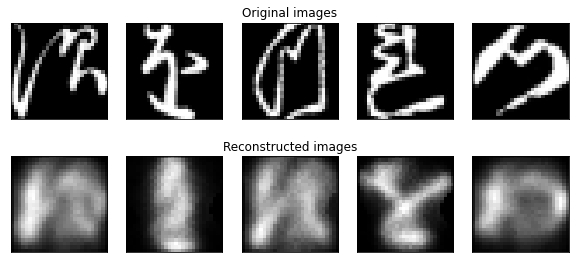


 EPOCH 37/100 	 train loss 0.19818191975355148 	 val loss 0.09606567646066348 	 csd 0.001018816139549017


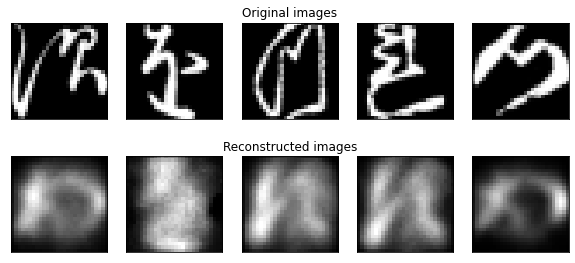


 EPOCH 38/100 	 train loss 0.19281718383232752 	 val loss 0.09465969602266948 	 csd 0.0009738394292071462


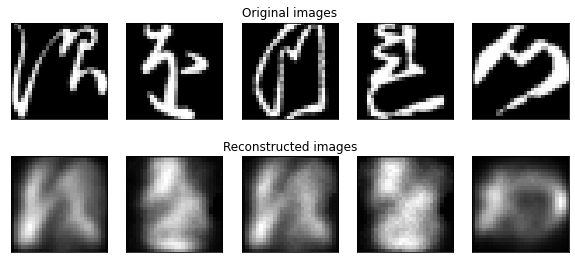


 EPOCH 39/100 	 train loss 0.1873570599903663 	 val loss 0.09453604991237323 	 csd 0.000927693909034133


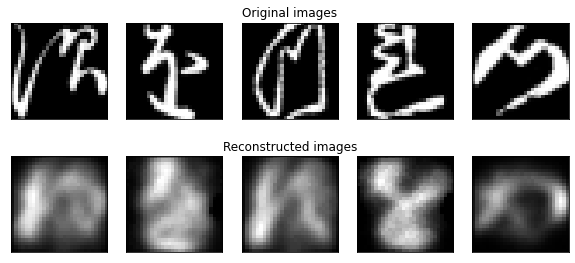


 EPOCH 40/100 	 train loss 0.18648312675456205 	 val loss 0.09434342198073864 	 csd 0.000922517036087811


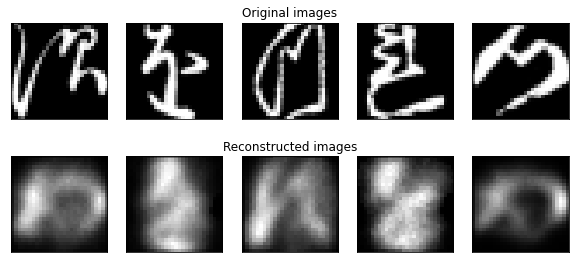


 EPOCH 41/100 	 train loss 0.18762162451942763 	 val loss 0.0950217650582393 	 csd 0.0009324712445959449


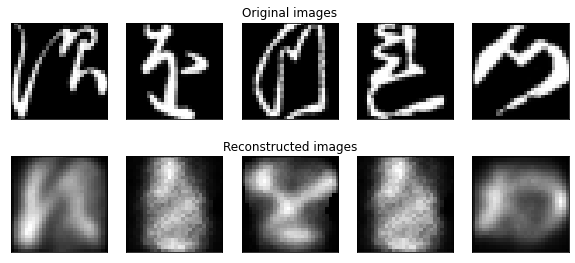


 EPOCH 42/100 	 train loss 0.18942359555512667 	 val loss 0.09473187662661076 	 csd 0.0009460072033107281


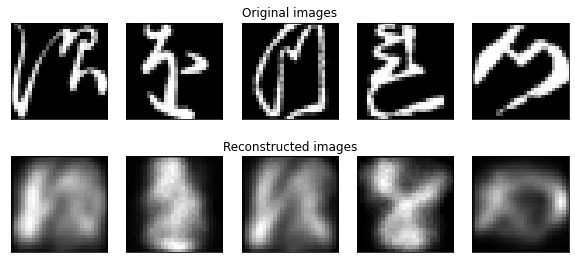


 EPOCH 43/100 	 train loss 0.1828741372252504 	 val loss 0.09324754774570465 	 csd 0.0008911629556678236


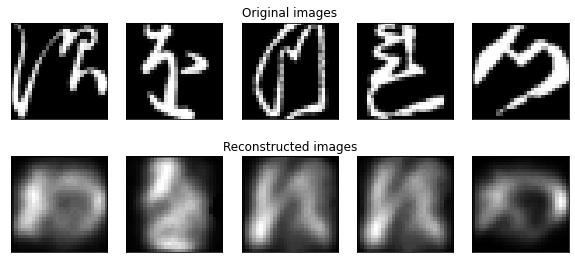


 EPOCH 44/100 	 train loss 0.1857590675354004 	 val loss 0.09287751590212186 	 csd 0.0009246555855497718


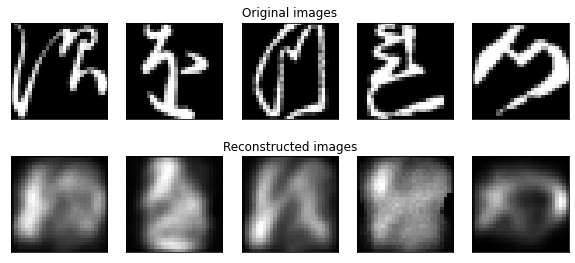


 EPOCH 45/100 	 train loss 0.18562833747516075 	 val loss 0.0941625963896513 	 csd 0.0009177596075460315


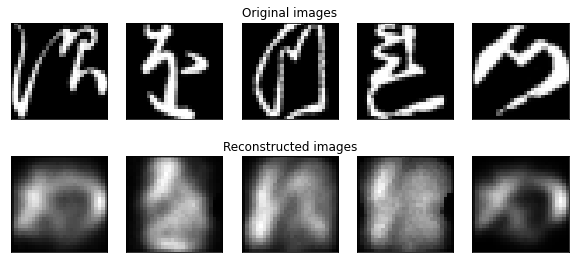


 EPOCH 46/100 	 train loss 0.18578795809298754 	 val loss 0.09338062691191833 	 csd 0.0009246536064893007


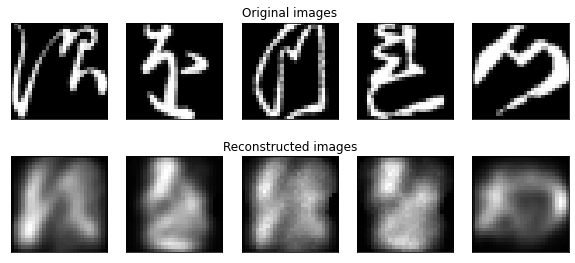


 EPOCH 47/100 	 train loss 0.17136113780240217 	 val loss 0.09261586889624596 	 csd 0.0007851728005334735


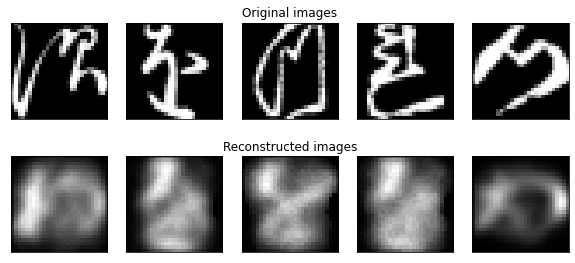


 EPOCH 48/100 	 train loss 0.16038710934420428 	 val loss 0.09303219864765803 	 csd 0.0006735834176652133


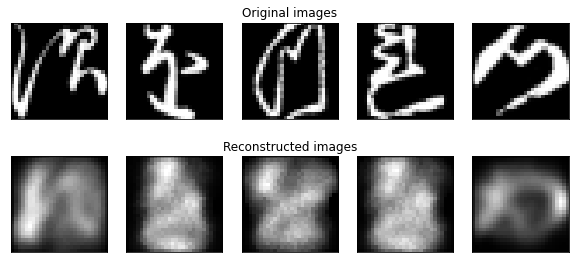


 EPOCH 49/100 	 train loss 0.14782442742337784 	 val loss 0.0924946212520202 	 csd 0.0005534740048460662


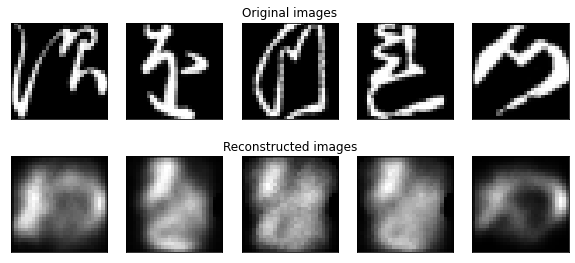


 EPOCH 50/100 	 train loss 0.150203972744445 	 val loss 0.0919619935254256 	 csd 0.0005809562280774117


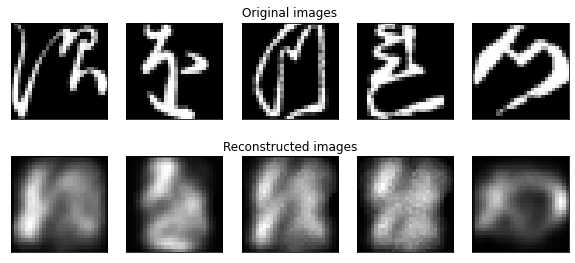


 EPOCH 51/100 	 train loss 0.14878666462997595 	 val loss 0.09231161947051685 	 csd 0.000569805852137506


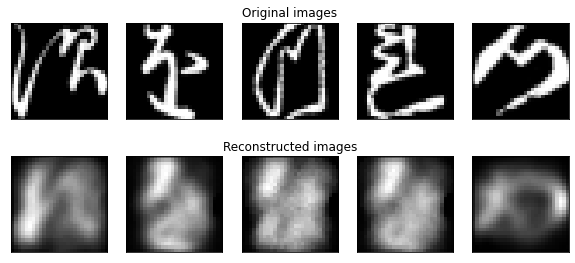


 EPOCH 52/100 	 train loss 0.1476981610370179 	 val loss 0.09228012089927991 	 csd 0.0005522355204448104


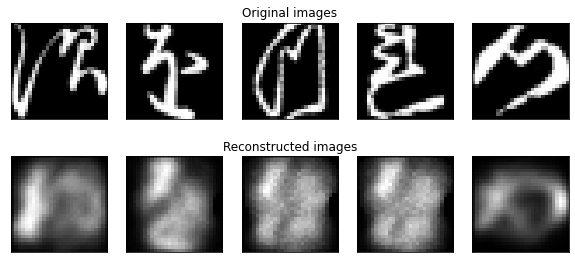


 EPOCH 53/100 	 train loss 0.1456110868602991 	 val loss 0.09173270563284557 	 csd 0.0005401346134021878


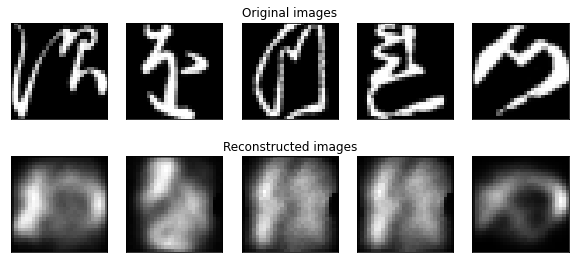


 EPOCH 54/100 	 train loss 0.14478525146842003 	 val loss 0.09158974885940552 	 csd 0.0005347354453988373


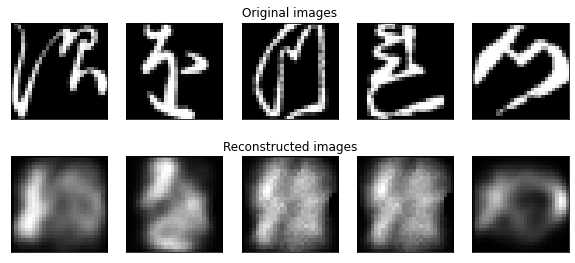


 EPOCH 55/100 	 train loss 0.14187773844848076 	 val loss 0.09160883041719596 	 csd 0.0004945299588143826


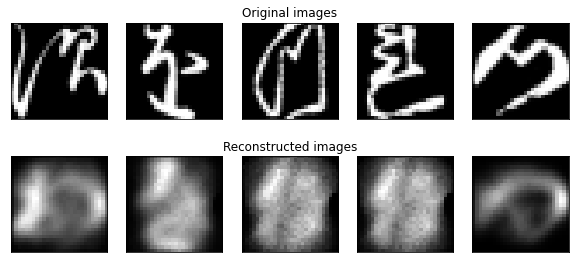


 EPOCH 56/100 	 train loss 0.1384733603335917 	 val loss 0.0917253711571296 	 csd 0.00047195269144140184


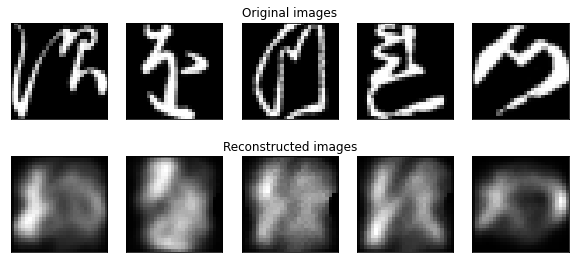


 EPOCH 57/100 	 train loss 0.13418830403437218 	 val loss 0.09121690193812053 	 csd 0.0004321364394854754


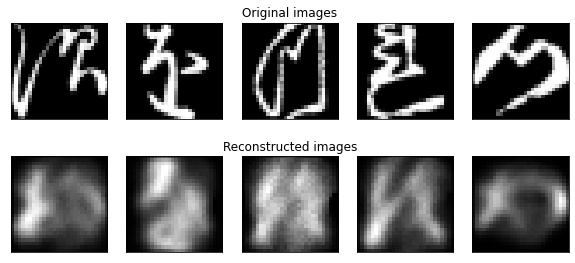


 EPOCH 58/100 	 train loss 0.13243438427646956 	 val loss 0.09052334663768609 	 csd 0.00040123023791238666


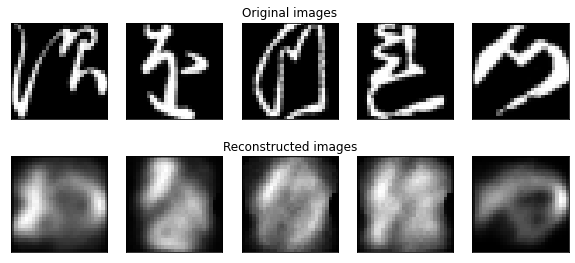


 EPOCH 59/100 	 train loss 0.1277957436007758 	 val loss 0.09029083140194416 	 csd 0.00036536133848130703


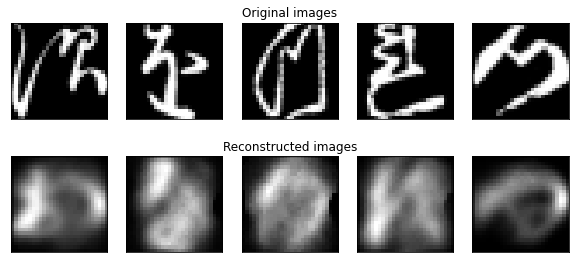


 EPOCH 60/100 	 train loss 0.1305084990647932 	 val loss 0.09093335457146168 	 csd 0.00040218624053522944


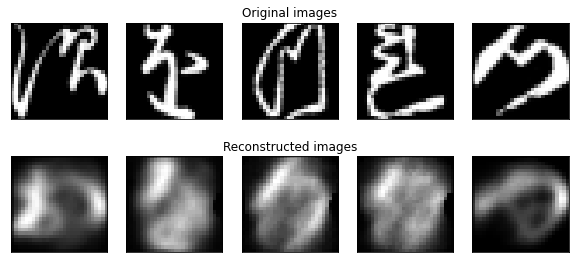


 EPOCH 61/100 	 train loss 0.11602198642988999 	 val loss 0.08981440650920074 	 csd 0.00026294810231775045


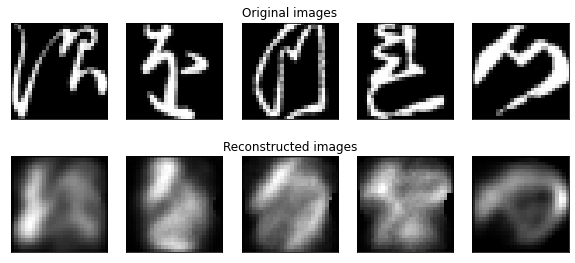


 EPOCH 62/100 	 train loss 0.11373738152906299 	 val loss 0.08984370591739814 	 csd 0.0002447749429848045


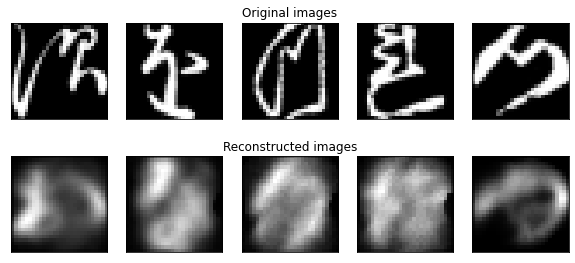


 EPOCH 63/100 	 train loss 0.1167561945815881 	 val loss 0.08899830219646294 	 csd 0.00027761381352320313


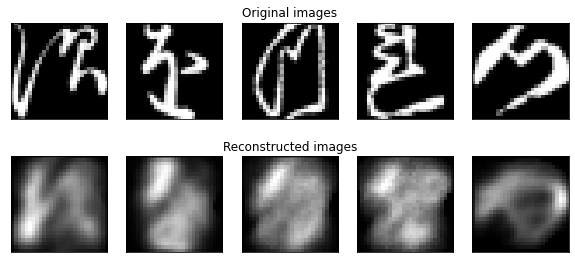


 EPOCH 64/100 	 train loss 0.11241771699860692 	 val loss 0.0890911432603995 	 csd 0.00023811279970686883


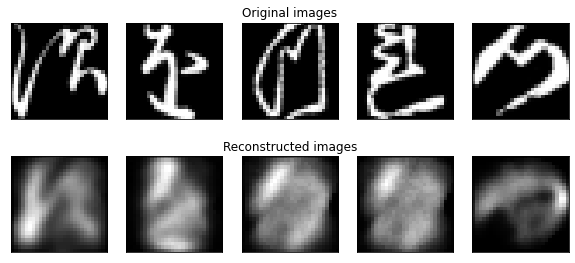


 EPOCH 65/100 	 train loss 0.11787965226297577 	 val loss 0.08827204257249832 	 csd 0.00029507436556741595


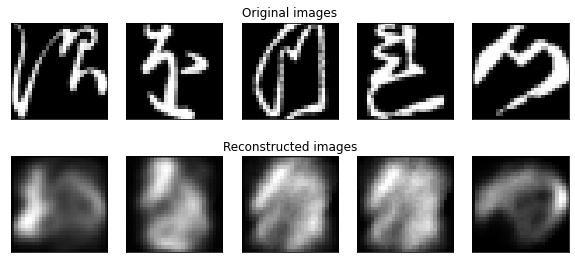


 EPOCH 66/100 	 train loss 0.10957805486395955 	 val loss 0.08907729511459668 	 csd 0.0002134439127985388


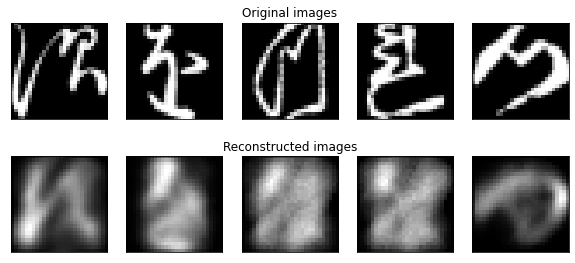


 EPOCH 67/100 	 train loss 0.10888265911489725 	 val loss 0.08747772127389908 	 csd 0.00021275519975461066


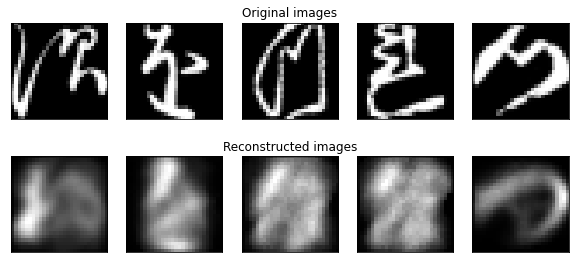


 EPOCH 68/100 	 train loss 0.10997586433465283 	 val loss 0.08954415780802567 	 csd 0.00022169358271639794


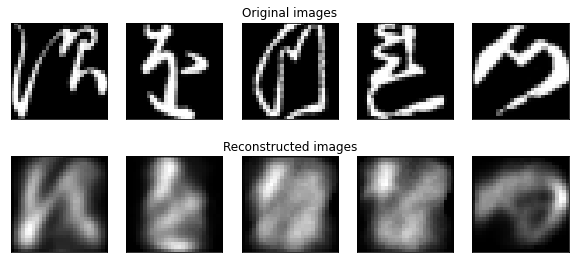


 EPOCH 69/100 	 train loss 0.11147832994659741 	 val loss 0.08859445713460445 	 csd 0.00023544741270598024


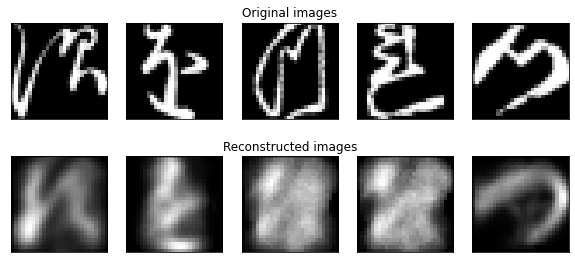


 EPOCH 70/100 	 train loss 0.10919313722600539 	 val loss 0.0885604831079642 	 csd 0.00021903541346546263


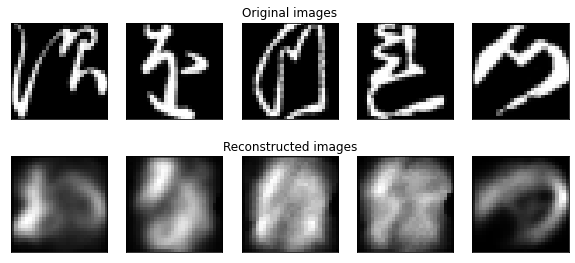


 EPOCH 71/100 	 train loss 0.10907578670109312 	 val loss 0.08664681389927864 	 csd 0.00021766893041785806


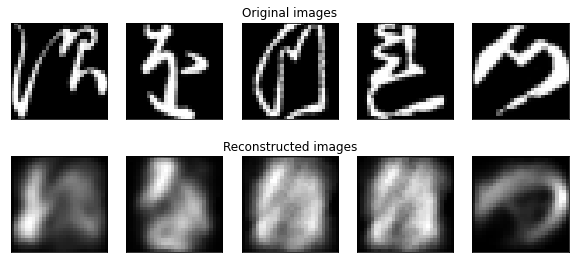


 EPOCH 72/100 	 train loss 0.1078949944737057 	 val loss 0.08983043767511845 	 csd 0.00021207348618190736


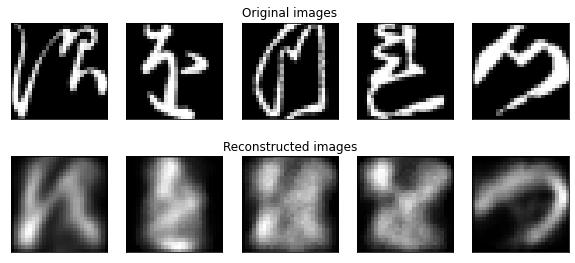


 EPOCH 73/100 	 train loss 0.10860672701771061 	 val loss 0.0878187691171964 	 csd 0.00021014042431488633


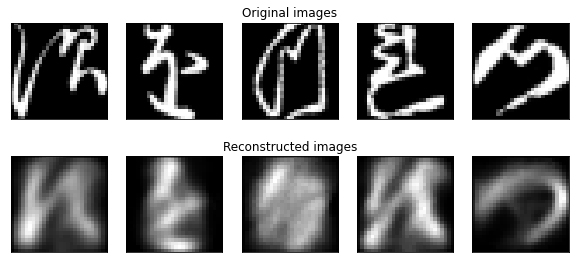


 EPOCH 74/100 	 train loss 0.1128898758130769 	 val loss 0.08811680662135284 	 csd 0.0002553279045969248


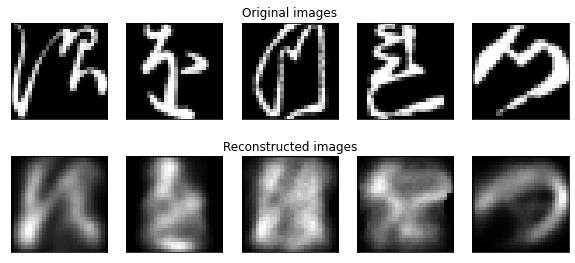


 EPOCH 75/100 	 train loss 0.11437479282418887 	 val loss 0.08631422619024913 	 csd 0.00026881531812250614


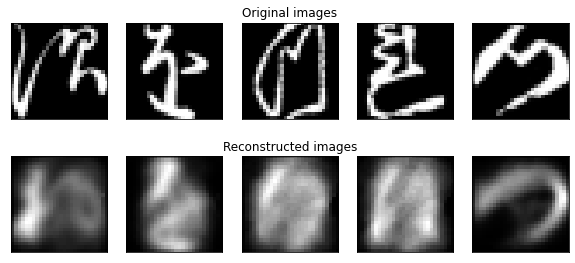


 EPOCH 76/100 	 train loss 0.11109284389143188 	 val loss 0.08609995742638905 	 csd 0.0002469621831551194


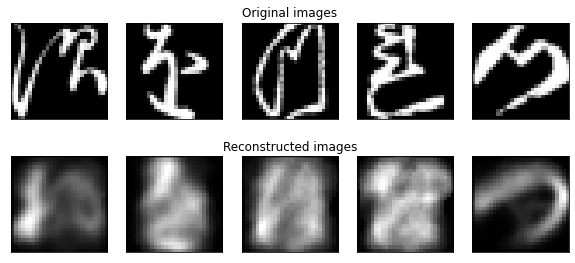


 EPOCH 77/100 	 train loss 0.10783011730139454 	 val loss 0.08631050710876782 	 csd 0.00021680652571376413


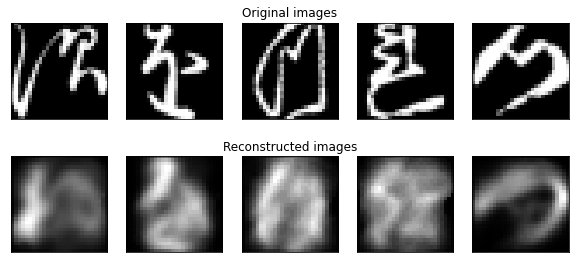


 EPOCH 78/100 	 train loss 0.11380004277452826 	 val loss 0.08576072690387566 	 csd 0.0002742251963354647


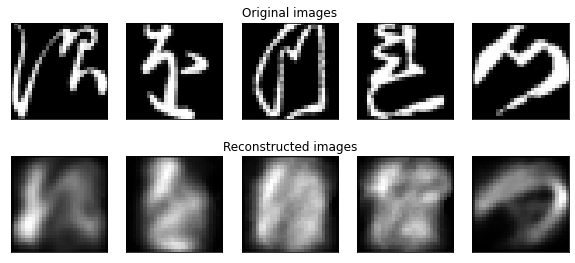


 EPOCH 79/100 	 train loss 0.11205559937904279 	 val loss 0.08546280488371849 	 csd 0.00026013716706074774


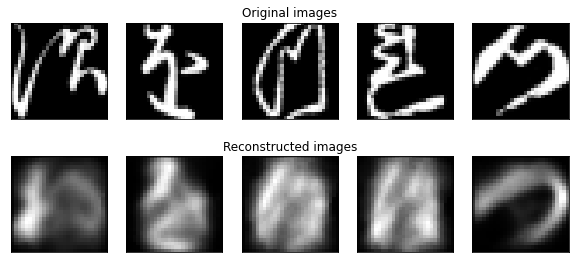


 EPOCH 80/100 	 train loss 0.10572445951402187 	 val loss 0.08556497221191724 	 csd 0.00020389944256749004


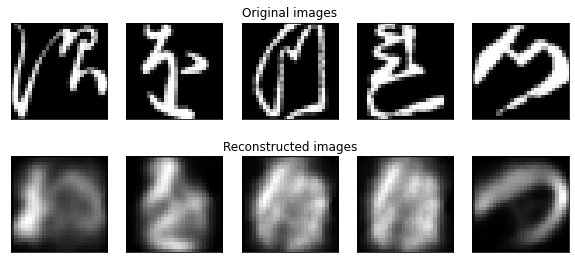


 EPOCH 81/100 	 train loss 0.11018639182051022 	 val loss 0.08550014905631542 	 csd 0.00024249328998848796


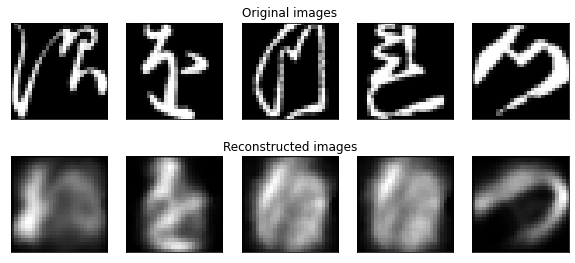


 EPOCH 82/100 	 train loss 0.10497868619859219 	 val loss 0.08525110222399235 	 csd 0.0002003606059588492


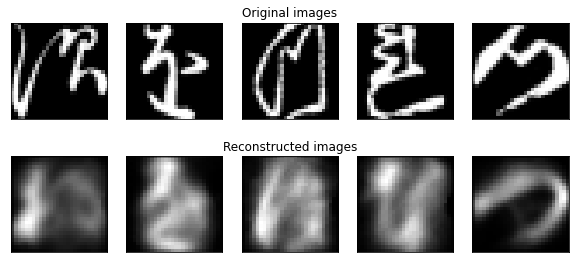


 EPOCH 83/100 	 train loss 0.11083968061332901 	 val loss 0.08564674978454907 	 csd 0.0002567792253103107


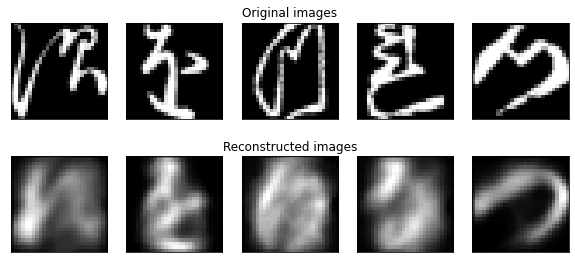


 EPOCH 84/100 	 train loss 0.10900503893693288 	 val loss 0.08528327383100986 	 csd 0.00023260140733327717


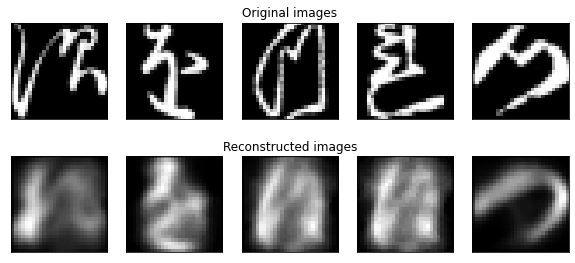


 EPOCH 85/100 	 train loss 0.10567910674338539 	 val loss 0.0871683806180954 	 csd 0.00020748730457853526


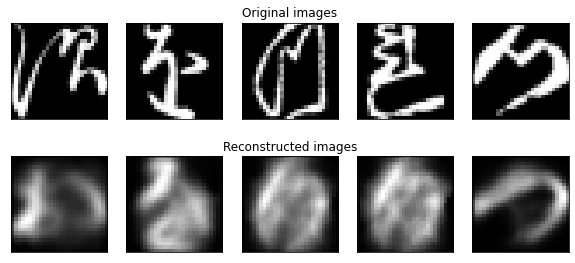


 EPOCH 86/100 	 train loss 0.10785030480474234 	 val loss 0.08505432059367497 	 csd 0.00022825661289971322


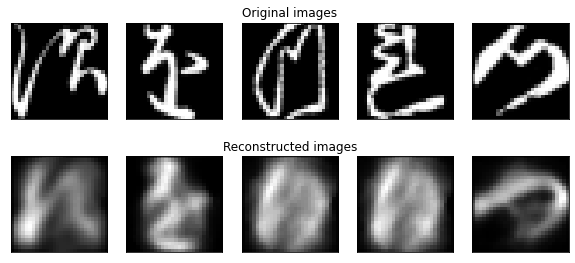


 EPOCH 87/100 	 train loss 0.10523996672903498 	 val loss 0.0847482942044735 	 csd 0.00020079540263395756


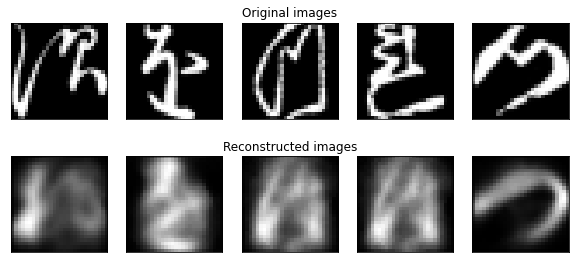


 EPOCH 88/100 	 train loss 0.10438385186716914 	 val loss 0.08414543978869915 	 csd 0.00019817268184851855


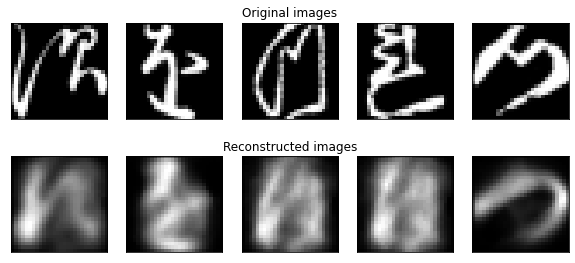


 EPOCH 89/100 	 train loss 0.10420960917448004 	 val loss 0.08390288924177487 	 csd 0.0001990663295146078


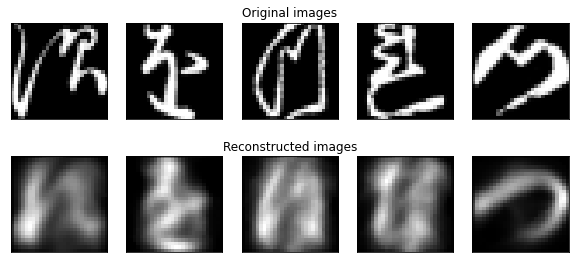


 EPOCH 90/100 	 train loss 0.1084559983573854 	 val loss 0.08376181684434414 	 csd 0.00024501653388142586


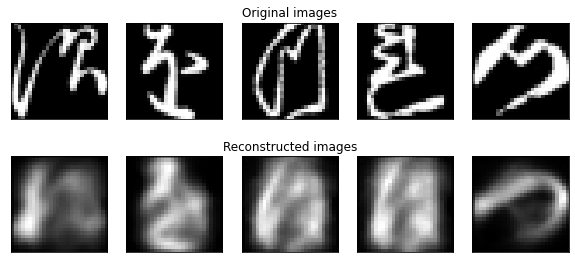


 EPOCH 91/100 	 train loss 0.10433082655072212 	 val loss 0.08409011115630467 	 csd 0.00020776022574864328


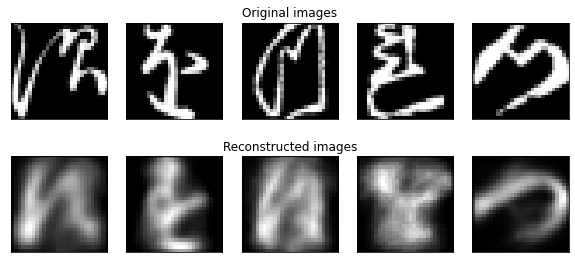


 EPOCH 92/100 	 train loss 0.10959042934700847 	 val loss 0.08420910065372784 	 csd 0.0002523634466342628


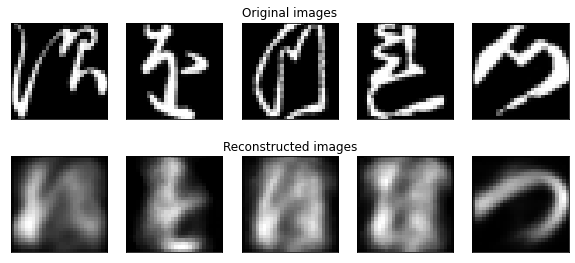


 EPOCH 93/100 	 train loss 0.10678219407175978 	 val loss 0.0846768245100975 	 csd 0.00023011746816337109


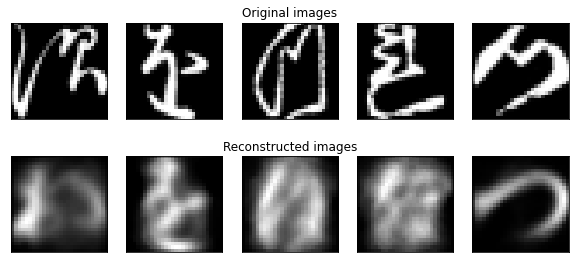


 EPOCH 94/100 	 train loss 0.10335736939062674 	 val loss 0.08349965202311675 	 csd 0.0001969416916836053


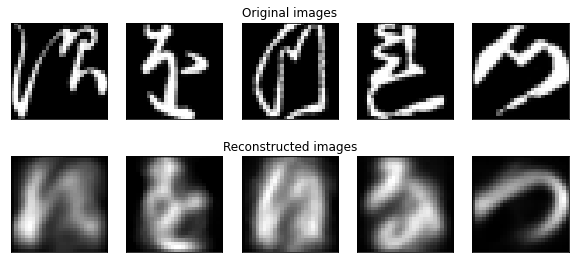


 EPOCH 95/100 	 train loss 0.10420859496419628 	 val loss 0.08338527257243793 	 csd 0.0002000271197175607


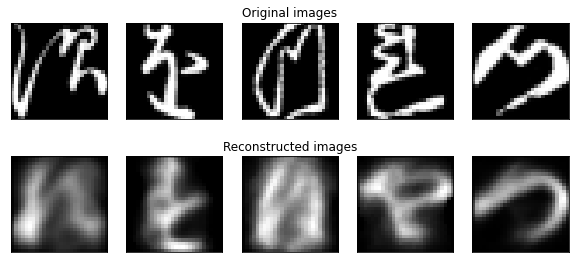


 EPOCH 96/100 	 train loss 0.10245035247256358 	 val loss 0.08353831929465134 	 csd 0.0001920041104312986


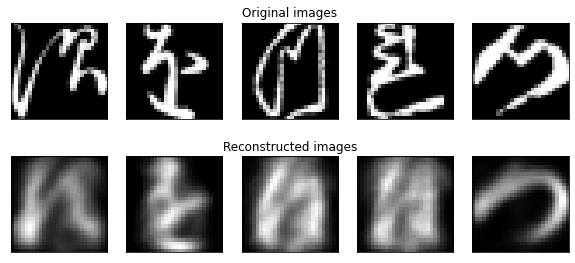


 EPOCH 97/100 	 train loss 0.10457061231136322 	 val loss 0.0845188790311416 	 csd 0.00021124232443980873


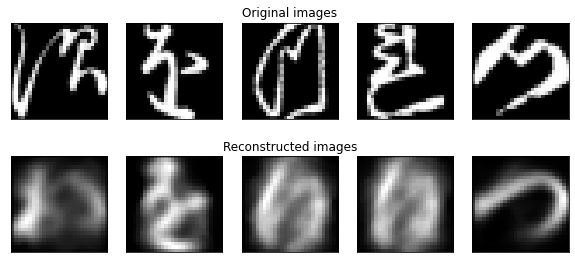


 EPOCH 98/100 	 train loss 0.10570850657920043 	 val loss 0.08313415261606376 	 csd 0.0002253431302960962


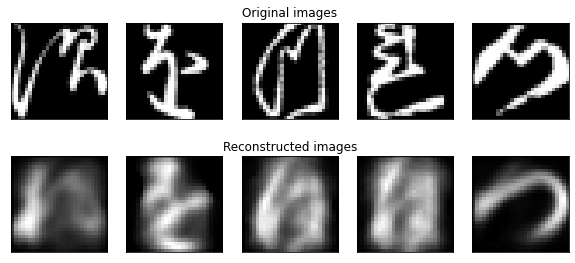


 EPOCH 99/100 	 train loss 0.101703815938284 	 val loss 0.08311168290674686 	 csd 0.00018937104323413223


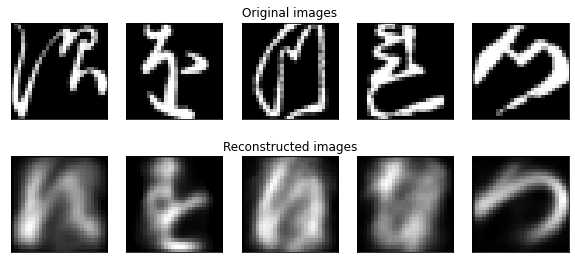


 EPOCH 100/100 	 train loss 0.10103851898262899 	 val loss 0.08311613090336323 	 csd 0.00018474389798939228


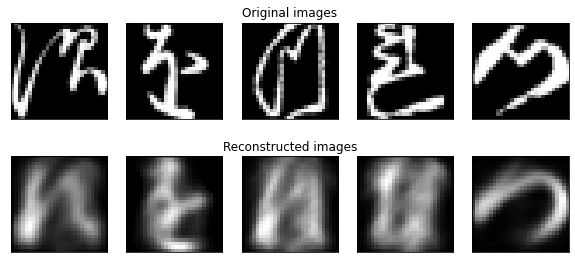

In [ ]:
num_epochs = 100
train_losses2 = []
val_losses2 = []
csd2 = []
for epoch in range(num_epochs):
    train_loss, csd = train_epoch(ae2,device,train_dataloader,optim)
    val_loss = test_epoch(ae2,device,val_dataloader)
    train_losses2.append(train_loss)
    val_losses2.append(val_loss)
    csd2.append(csd)
    print('\n EPOCH {}/{} \t train loss {} \t val loss {} \t csd {}'.format(epoch + 1, num_epochs,train_loss,val_loss, csd))
    plot_ae_outputs(ae2.encoder,ae2.decoder,n=5)

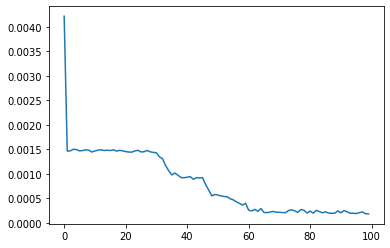

In [ ]:
plt.plot(csd2)

In [ ]:
encoded_samples2 = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    # Encode image
    ae2.eval()
    with torch.no_grad():
        encoded_img  = ae2.encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples2.append(encoded_sample)
    
encoded_samples2 = pd.DataFrame(encoded_samples2)
encoded_samples2

  0%|          | 0/10000 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:1795: UserWarning:

nn.functional.tanh is deprecated. Use torch.tanh instead.

100%|██████████| 10000/10000 [00:13<00:00, 752.62it/s]


,Enc. Variable 0,Enc. Variable 1,Enc. Variable 2,label
0,-0.847399,14.658254,-5.985353,"tensor(2, dtype=torch.uint8)"
1,10.508014,12.606549,8.422702,"tensor(9, dtype=torch.uint8)"
2,7.831441,12.291109,1.720449,"tensor(3, dtype=torch.uint8)"
3,9.236983,12.946219,4.744784,"tensor(8, dtype=torch.uint8)"
4,9.678098,-0.057899,-7.094930,"tensor(3, dtype=torch.uint8)"
...,...,...,...,...
9995,9.708723,13.266287,6.042906,"tensor(4, dtype=torch.uint8)"
9996,-0.587631,14.245718,-7.025960,"tensor(0, dtype=torch.uint8)"
9997,10.471716,12.613865,8.474871,"tensor(9, dtype=torch.uint8)"
9998,-0.775776,14.547536,-6.197390,"tensor(4, dtype=torch.uint8)"


In [ ]:
torch.save(ae2.state_dict(), "/content/drive/MyDrive/project2/Swiss_roll_1_0.075_1000")

In [ ]:
1, 0.075
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# 1, 0.05
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
1, 0.05
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# 1, 0.1
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
1, 0.1
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
def swiss_sorted(n_samples,noise=0.1):
    u1 = torch.linspace(0, 1,n_samples)
    u2 = torch.linspace(0, 1,n_samples)
    t = 1.5*torch.pi*(1.0+2.0*u1)
    x = t*torch.cos(t)
    y = 21.0*u2
    z = t*torch.sin(t)
    xz = torch.vstack((x,z)).T
    ft = torch.ones([n_samples,n_samples,3])
    for col in range(10):
      ft[:,col,[0,2]] = xz
      ft[col,:,1] = y
    return ft
def plot_reconstructed_by_swiss_sort(decoder, n=10):
  plt.figure(figsize=(20, 8.5))
  w = 28
  img = np.zeros((n*w, n*w))
  s = swiss_sorted(n)
  for i in range(n):
    for j in range(n):
      x, y, z = s[i][j]
      # x, z = s[i][j]
      m = torch.Tensor([x, y, z]).to(device)
      # m = torch.Tensor([x, z]).to(device)
      x_hat = decoder(m)
      x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
      img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
  plt.imshow(img, cmap='gist_gray')

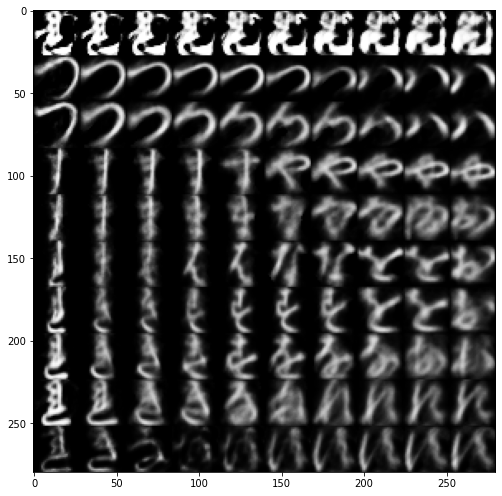

In [ ]:
# 1, 0.075
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

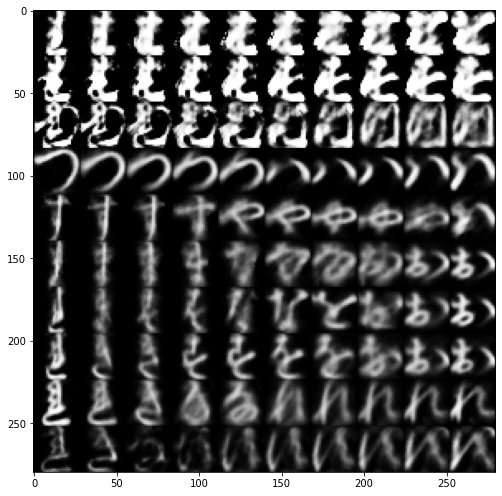

In [ ]:
# 1, 0.075
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

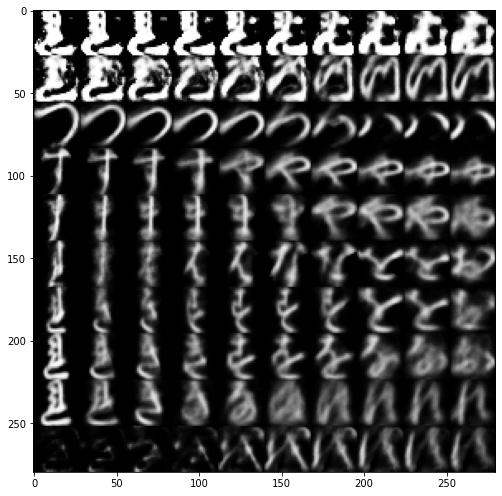

In [ ]:
# 1, 0.05
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

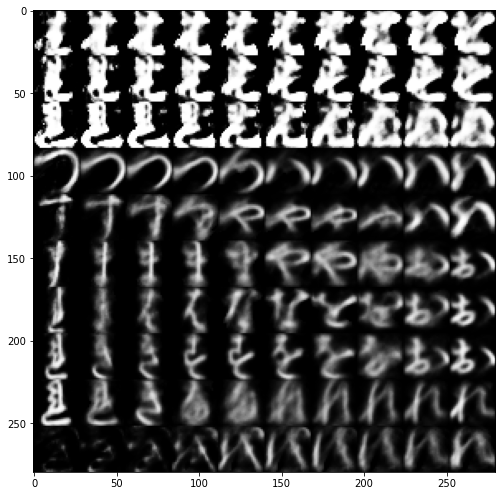

In [ ]:
# 1, 0.05
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

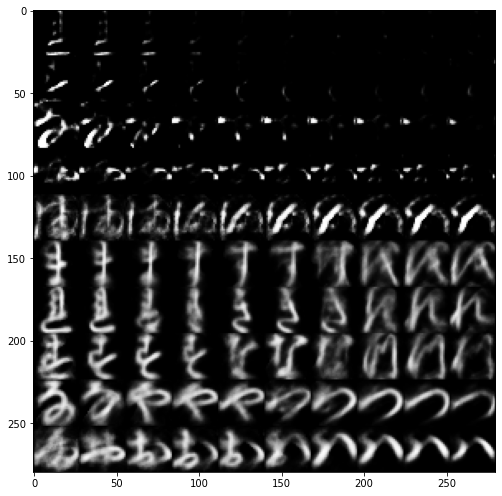

In [ ]:
# 1, 0.01
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

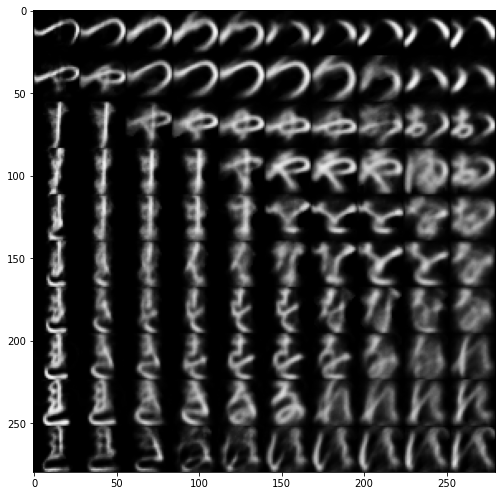

In [ ]:
# 1, 0.1
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

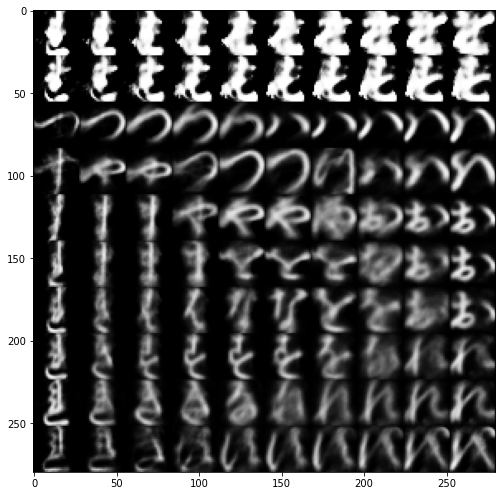

In [ ]:
# 1, 0.1
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

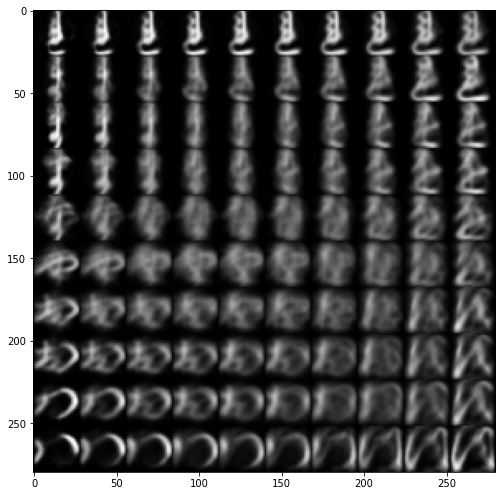

In [ ]:
# 1, 100
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

# kernel

In [ ]:
1, 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
10, 10
# px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
10, 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# fig = px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.lab
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
100, 10
# px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
100, 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# fig = px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.lab
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
1000, 10
# px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
1000, 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# fig = px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.lab
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
1, 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# fig = px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.lab
# plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
fig = px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# fig = px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.lab
plotly.offline.iplot(fig, filename='/content/drive/MyDrive/project2/filename.png')

In [ ]:
# Kernel_size = 10, lambda = 0.1 batch_size = 100
# px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 0.1 batch_size = 100
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 0.1 batch_size = 100
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 1 batch_size = 100
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.05 batch_size = 100
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

#Batch-10000

In [ ]:
# Kernel_size = 1, lambda = 0.5 batch_size = 10000
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.05 batch_size = 10000
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

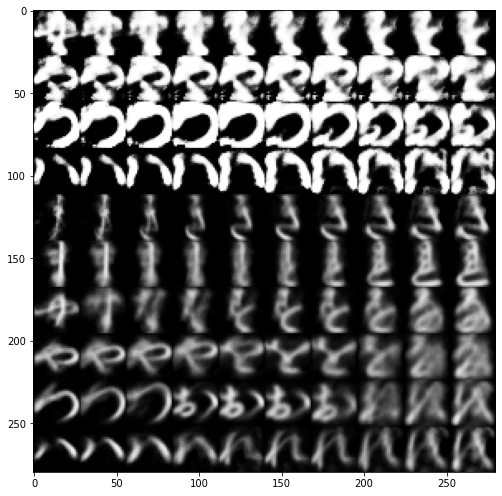

In [ ]:
# 1, 0.05 batch_size = 10000
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

# Batch-1000

In [ ]:
# Kernel_size = 1, lambda = 0.5 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 100, lambda = 0.5 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 100, lambda = 5 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 100, lambda = 0.05 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.05 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.001 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.0001 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 1, lambda = 0.1 
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 5 Kmnist epochs = 300
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 5 Kmnist
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 5 Kmnist
# px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 5
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)
# px.scatter(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 0.5
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 0.1
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 10, lambda = 1
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
# Kernel_size = 100, lambda = 10
px.scatter_3d(encoded_samples2, x='Enc. Variable 0', y='Enc. Variable 1', z='Enc. Variable 2', color=encoded_samples2.label.astype(str), opacity=0.7)

In [ ]:
def swiss_sorted(n_samples,noise=0.1):
    u1 = torch.linspace(0, 1,n_samples)
    u2 = torch.linspace(0, 1,n_samples)
    t = 1.5*torch.pi*(1.0+2.0*u1)
    x = t*torch.cos(t)
    y = 21.0*u2
    z = t*torch.sin(t)
    xz = torch.vstack((x,z)).T
    ft = torch.ones([n_samples,n_samples,3])
    for col in range(10):
      ft[:,col,[0,2]] = xz
      ft[col,:,1] = y
    return ft
def plot_reconstructed_by_swiss_sort(decoder, n=10):
  plt.figure(figsize=(20, 8.5))
  w = 28
  img = np.zeros((n*w, n*w))
  s = swiss_sorted(n)
  for i in range(n):
    for j in range(n):
      x, y, z = s[i][j]
      # x, z = s[i][j]
      m = torch.Tensor([x, y, z]).to(device)
      # m = torch.Tensor([x, z]).to(device)
      x_hat = decoder(m)
      x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
      img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
  plt.imshow(img, cmap='gist_gray')
# 1, 0.05
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

In [ ]:
def swiss_sorted_2d(n_samples,noise=0.1):
    u1 = torch.linspace(0,1,n_samples)
    # u2 = torch.linspace(0,1,n_samples)
    t = 1.5*torch.pi*(1.0+2.0*u1)
    x = t*torch.cos(t)
    # y = 21.0*u2
    z = t*torch.sin(t)
    xz = torch.vstack((x,z)).T
    # ft = torch.ones([n_samples,n_samples,2])
    ft = xz
    # for col in range(10):
      # ft[:,col,[0,1]] = xz
      # ft[col,:,1] = y
    return ft

In [ ]:
def plot_reconstructed_by_swiss_sort(decoder, n=10):
  plt.figure(figsize=(20, 8.5))
  w = 28
  img = np.zeros((n*w, n*w))
  s = swiss_sorted(n)
  for i in range(n):
    for j in range(n):
      x, y, z = s[i][j]
      # x, z = s[i][j]
      m = torch.Tensor([x, y, z]).to(device)
      # m = torch.Tensor([x, z]).to(device)
      x_hat = decoder(m)
      x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
      img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
  plt.imshow(img, cmap='gist_gray')

In [ ]:
def plot_reconstructed_by_swiss_sort_2d(decoder, n=10):
  plt.figure(figsize=(20, 8.5))
  w = 28
  img = np.zeros((n*w, n*w))
  s = swiss_sorted_2d(n**2)
  # for i in range(n):
    # for j in range(n):
      # x, y, z = s[i][j]
      # x, z = s[i][j]
      # m = torch.Tensor([x, y, z]).to(device)
  i = 0
  print(s.shape)
  for j, (x, z) in enumerate(s):
    if j != 0:
      if j % 10 == 0:
        i += 1
    m = torch.Tensor([x, z]).to(device)
    x_hat = decoder(m)
    x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
    # print(i, j)
    img[(n-1-i)*w:(n-1-i+1)*w, (j%10)*w:((j%10)+1)*w] = x_hat
  plt.imshow(img, cmap='gist_gray')

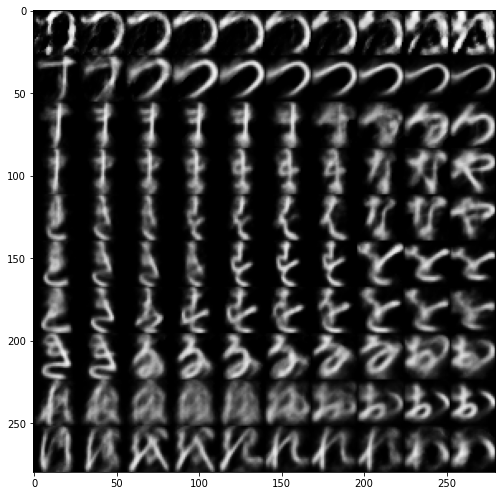

In [ ]:
# 1, 0.05
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

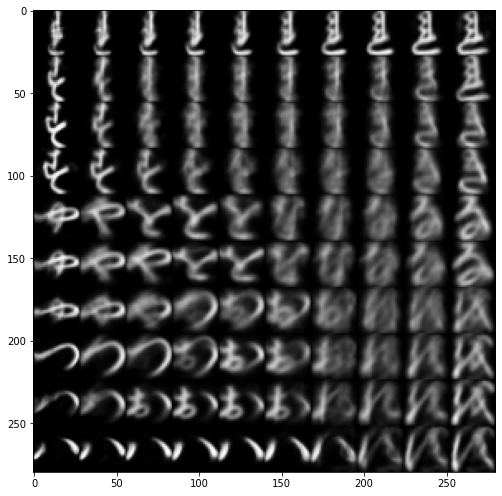

In [ ]:
# 1, 0.5
plot_reconstructed_by_swiss_sort(ae2.decoder, n=10)

In [ ]:
plot_reconstructed_by_swiss_sort_2d(ae1.decoder, n=10)